# **Credit Score Classification for Paisabazaar**
## **Machine Learning Case Study | Financial Risk Assessment**

**Project Type** - EDA & Classification

**Contribution** - Individual

# **Project Summary**

In today's data-driven financial landscape, accurately assessing an individual’s creditworthiness is crucial for effective risk management and personalized customer service. This project focuses on developing a **machine learning classification model** to predict the **credit score category** of individuals based on various demographic and financial features. The dataset used contains detailed information about customers, including income, loan history, payment behavior, and other relevant attributes.

The primary objective of this project is to build a robust and interpretable classification system that can assist **Paisabazaar**, a leading financial services platform, in making informed decisions regarding loan approvals and credit product recommendations. By predicting whether a customer falls into a **'Poor'**, **'Standard'**, or **'Good'** credit score category, the model enhances decision-making capabilities and helps reduce the risk of loan defaults.

The project follows a structured machine learning pipeline, starting with **data loading and cleaning**, where missing values are imputed, irrelevant columns are removed, and inconsistencies are resolved. A thorough **Exploratory Data Analysis (EDA)** is conducted to understand feature distributions, correlations, and patterns within the data. Tools like `ydata-profiling` and visualizations such as bar plots, boxplots, and heatmaps provide insights into how different variables influence credit scores.

To enhance model performance, **feature engineering** techniques are applied to derive new meaningful features, such as debt-to-income ratio and total credit cards. A comprehensive preprocessing pipeline using `scikit-learn`'s `ColumnTransformer` and `Pipeline` ensures consistent transformations on both training and new unseen data.

The core of the project involves building and evaluating multiple classification models, including **Random Forest** and **XGBoost**, using appropriate evaluation metrics such as **accuracy**, **precision**, **recall**, and **F1-score**. Hyperparameter tuning via `GridSearchCV` is employed to optimize model performance. The final model is selected based on its ability to generalize well on the test set and align with business logic.

Model interpretability is addressed using **SHAP (SHapley Additive exPlanations)**, which provides insights into which features most significantly influence predictions. This not only adds transparency but also builds trust in the model from a business perspective.

Finally, the trained model and preprocessing pipeline are saved as `.pkl` files, enabling seamless integration into production environments such as REST APIs built with **FastAPI or Flask**. A mock inference function is also provided for quick testing.

This project serves as a foundation for scalable, automated credit assessment systems, paving the way for real-time scoring, personalized financial advice, and proactive risk mitigation at Paisabazaar.


# **Github Link**

# **Problem Statement**

Paisabazaar is a financial services company that helps customers find and apply for banking and credit products. Accurately predicting credit scores allows them to:
- Improve loan approval decisions
- Reduce default risk
- Offer personalized product recommendations

Paisabazaar needs an automated system to classify customer credit scores.
- Goal: Predict credit score categories (**Poor**, **Standard**, **Good**) using customer data.
- Features include income, loan history, payment behavior, and debt metrics.
- Current methods may not capture complex patterns in the data.
- A machine learning model will improve accuracy, reduce default risk, and enable personalized financial recommendations.

**Objective:** Build a scalable, interpretable classification model for accurate credit score prediction.

# **Setup & Dependencies**

In [ ]:
# Install required libraries
!pip install pandas numpy matplotlib seaborn scikit-learn ydata-profiling shap xgboost joblib

# **Load and Inspect data**

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.metrics import classification_report, confusion_matrix, f1_score
import shap
import joblib
import warnings
warnings.filterwarnings('ignore')

# Load the dataset
df = pd.read_csv('dataset-2.csv')
df.head()

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,5634,3392,1,Aaron Maashoh,23.0,821000265.0,Scientist,19114.12,1824.843333,3.0,...,Good,809.98,26.822620,265.0,No,49.574949,21.46538,High_spent_Small_value_payments,312.494089,Good
1,5635,3392,2,Aaron Maashoh,23.0,821000265.0,Scientist,19114.12,1824.843333,3.0,...,Good,809.98,31.944960,266.0,No,49.574949,21.46538,Low_spent_Large_value_payments,284.629162,Good
2,5636,3392,3,Aaron Maashoh,23.0,821000265.0,Scientist,19114.12,1824.843333,3.0,...,Good,809.98,28.609352,267.0,No,49.574949,21.46538,Low_spent_Medium_value_payments,331.209863,Good
3,5637,3392,4,Aaron Maashoh,23.0,821000265.0,Scientist,19114.12,1824.843333,3.0,...,Good,809.98,31.377862,268.0,No,49.574949,21.46538,Low_spent_Small_value_payments,223.451310,Good
4,5638,3392,5,Aaron Maashoh,23.0,821000265.0,Scientist,19114.12,1824.843333,3.0,...,Good,809.98,24.797347,269.0,No,49.574949,21.46538,High_spent_Medium_value_payments,341.489231,Good


# **Initial Inspection**

In [ ]:
# Display basic information about the dataset
df.info()

# Check for missing values
print("Missing values:\n", df.isnull().sum())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 28 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        100000 non-null  int64  
 1   Customer_ID               100000 non-null  int64  
 2   Month                     100000 non-null  int64  
 3   Name                      100000 non-null  object 
 4   Age                       100000 non-null  float64
 5   SSN                       100000 non-null  float64
 6   Occupation                100000 non-null  object 
 7   Annual_Income             100000 non-null  float64
 8   Monthly_Inhand_Salary     100000 non-null  float64
 9   Num_Bank_Accounts         100000 non-null  float64
 10  Num_Credit_Card           100000 non-null  float64
 11  Interest_Rate             100000 non-null  float64
 12  Num_of_Loan               100000 non-null  float64
 13  Type_of_Loan              100000 non-null  ob

In [ ]:
print(df.columns.tolist())

['ID', 'Customer_ID', 'Month', 'Name', 'Age', 'SSN', 'Occupation', 'Annual_Income', 'Monthly_Inhand_Salary', 'Num_Bank_Accounts', 'Num_Credit_Card', 'Interest_Rate', 'Num_of_Loan', 'Type_of_Loan', 'Delay_from_due_date', 'Num_of_Delayed_Payment', 'Changed_Credit_Limit', 'Num_Credit_Inquiries', 'Credit_Mix', 'Outstanding_Debt', 'Credit_Utilization_Ratio', 'Credit_History_Age', 'Payment_of_Min_Amount', 'Total_EMI_per_month', 'Amount_invested_monthly', 'Payment_Behaviour', 'Monthly_Balance', 'Credit_Score']


# **Data Cleaning & Wrangling**

In [ ]:
# Handle missing values
# Fill missing numerical values with median
numerical_cols = [
    'Monthly_Inhand_Salary', 'Num_Bank_Accounts', 'Num_Credit_Card', 'Interest_Rate',
    'Num_of_Loan', 'Delay_from_due_date', 'Num_of_Delayed_Payment', 'Changed_Credit_Limit',
    'Num_Credit_Inquiries', 'Outstanding_Debt', 'Credit_Utilization_Ratio',
    'Credit_History_Age', 'Total_EMI_per_month', 'Amount_invested_monthly',
    'Monthly_Balance'
]

for col in numerical_cols:
    df[col].fillna(df[col].median(), inplace=True)

# Fill missing categorical values with mode
categorical_cols = ['Occupation', 'Type_of_Loan', 'Payment_of_Min_Amount', 'Credit_Mix', 'Payment_Behaviour']

for col in categorical_cols:
    df[col].fillna(df[col].mode()[0], inplace=True)

# Drop unnecessary or irrelevant columns
df.drop(columns=['ID', 'Name', 'SSN', 'Customer_ID', 'Month'], inplace=True)

# Check and remove duplicates
print("Number of duplicates:", df.duplicated().sum())
df.drop_duplicates(inplace=True)

Number of duplicates: 0


# **Feature Analysis & Profiling**

In [ ]:
# Use ydata-profiling for detailed analysis
from ydata_profiling import ProfileReport
profile = ProfileReport(df, title='Pandas Profiling Report', explorative=True)
profile.to_notebook_iframe()


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 23/23 [00:05<00:00,  3.97it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# **EDA & Visualization**

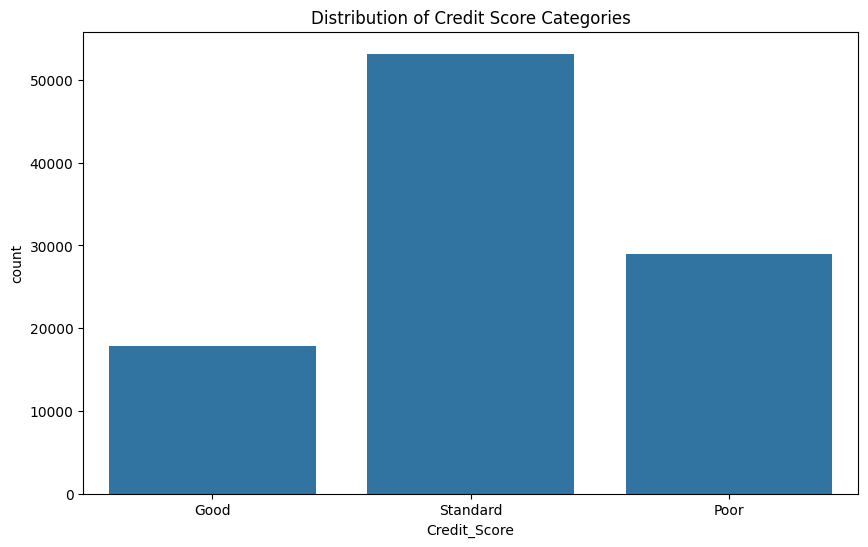

In [ ]:
# Distribution of Credit Score Categories
plt.figure(figsize=(10, 6))
sns.countplot(data=df, x='Credit_Score')
plt.title('Distribution of Credit Score Categories')
plt.show()

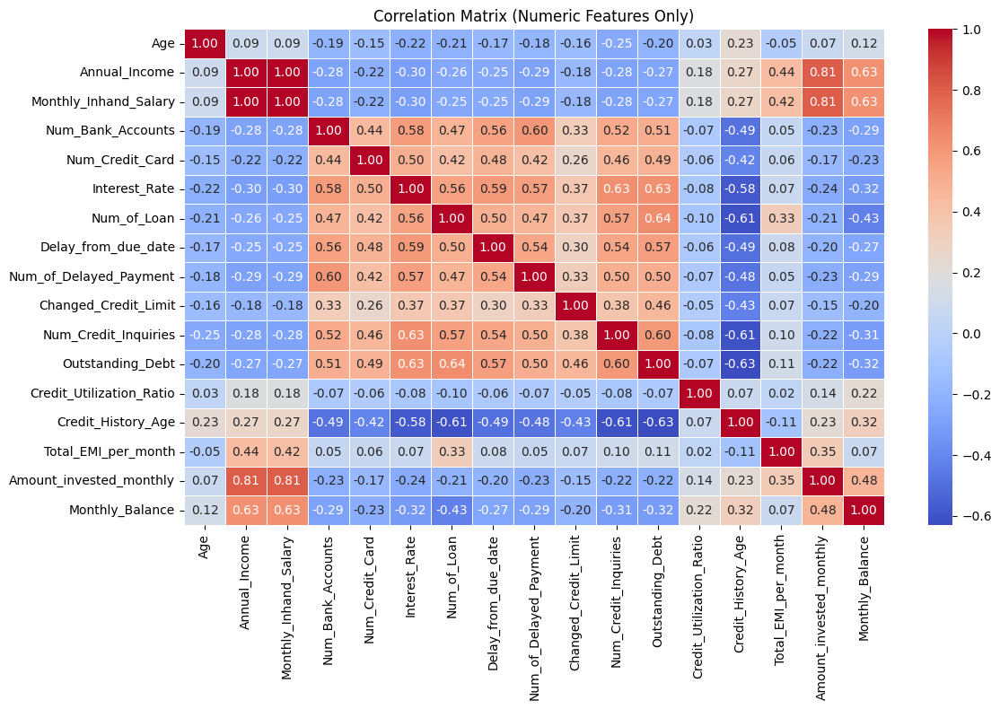

In [ ]:
# Select only numeric columns for correlation
numeric_df = df.select_dtypes(include=[np.number])

# Compute correlation matrix
correlation_matrix = numeric_df.corr()

# Plot heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Matrix (Numeric Features Only)')
plt.tight_layout()
plt.show()

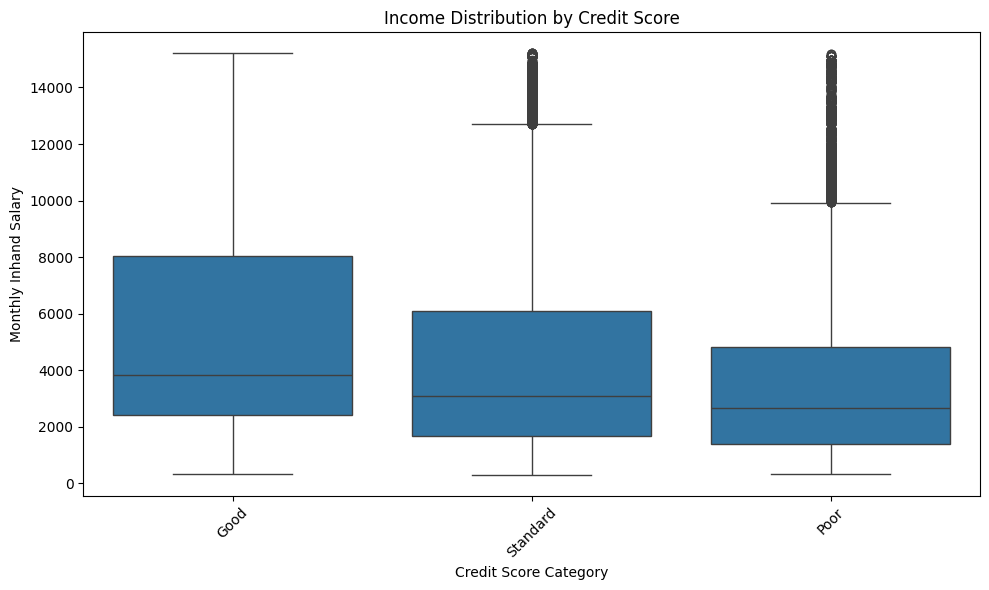

In [ ]:
# Relationship between Income and Credit Score
plt.figure(figsize=(10, 6))
sns.boxplot(data=df, x='Credit_Score', y='Monthly_Inhand_Salary')
plt.title('Income Distribution by Credit Score')
plt.xticks(rotation=45)
plt.ylabel('Monthly Inhand Salary')
plt.xlabel('Credit Score Category')
plt.tight_layout()
plt.show()

# **Hypothesis Testing**

In [ ]:
# Perform statistical tests (e.g., ANOVA for comparing income across credit score groups)
from scipy.stats import f_oneway

# Group data by Credit Score
groups = [group['Monthly_Inhand_Salary'].values for name, group in df.groupby('Credit_Score')]

# Perform ANOVA
f_stat, p_val = f_oneway(*groups)
print(f'ANOVA F-statistic: {f_stat}, p-value: {p_val}')

ANOVA F-statistic: 2330.737141294336, p-value: 0.0


# **Feature Engineering & Preprocessing Pipeline**

In [ ]:
# Create derived features
df['Debt_to_Income_Ratio'] = df['Outstanding_Debt'] / df['Monthly_Inhand_Salary']
df['Total_Credit_Cards'] = df['Num_Credit_Card'] + df['Num_of_Loan']

# Define preprocessing pipeline
numeric_features = [
    'Age', 'Annual_Income', 'Monthly_Inhand_Salary', 'Num_Bank_Accounts',
    'Num_Credit_Card', 'Interest_Rate', 'Num_of_Loan', 'Delay_from_due_date',
    'Num_of_Delayed_Payment', 'Changed_Credit_Limit', 'Num_Credit_Inquiries',
    'Outstanding_Debt', 'Credit_Utilization_Ratio', 'Credit_History_Age',
    'Total_EMI_per_month', 'Amount_invested_monthly', 'Monthly_Balance'
]

categorical_features = ['Occupation', 'Type_of_Loan', 'Credit_Mix', 'Payment_of_Min_Amount', 'Payment_Behaviour']

# Numeric transformer
numeric_transformer = StandardScaler()

# Categorical transformer
categorical_transformer = OneHotEncoder(handle_unknown='ignore')

# ColumnTransformer - Build preprocessing pipeline
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ])

# Save preprocessor
joblib.dump(preprocessor, 'preprocessor.pkl')

['preprocessor.pkl']

# **Train/Test Split**

In [ ]:
# Separate features and target
X = df.drop('Credit_Score', axis=1)
y = df['Credit_Score']

# Split into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# **Model Training & Evaluation**

In [ ]:
# Initialize and train a Random Forest Classifier
model = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', RandomForestClassifier(random_state=42))
])

model.fit(X_train, y_train)
y_pred = model.predict(X_test)

# Evaluate the model
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

        Good       0.77      0.77      0.77      3566
        Poor       0.79      0.82      0.81      5799
    Standard       0.83      0.81      0.82     10635

    accuracy                           0.81     20000
   macro avg       0.80      0.80      0.80     20000
weighted avg       0.81      0.81      0.81     20000



# **Hyperparameter Tuning**

In [ ]:
# Define hyperparameter grid for Random Forest
param_grid = {
    'classifier__n_estimators': [50, 100],
    'classifier__max_depth': [3, 5]
}

grid_search = GridSearchCV(
    model,
    param_grid,
    cv=2,
    scoring='f1_macro',
    n_jobs=-1  # Enable parallel processing
)

grid_search.fit(X_train, y_train)
best_model = grid_search.best_estimator_

# **Model Interpretation with SHAP**

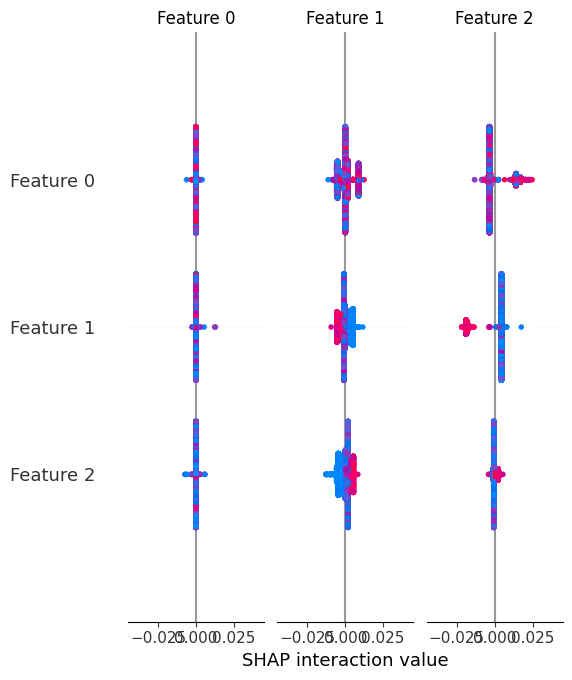

In [ ]:
# Step 1: Take a small sample of training data for SHAP explanation
X_train_sample = X_train.sample(frac=0.2, random_state=42)  # Use only 20% of the data

# Step 2: Preprocess the sampled data
X_train_sample_preprocessed = best_model.named_steps['preprocessor'].transform(X_train_sample)

# Step 3: Convert to dense array only if necessary
try:
    X_train_sample_preprocessed = X_train_sample_preprocessed.toarray()
except AttributeError:
    pass  # Already a NumPy array

# Step 4: Ensure float type for SHAP compatibility
X_train_sample_preprocessed = X_train_sample_preprocessed.astype(np.float32)

# Step 5: Initialize SHAP explainer and compute values
explainer = shap.TreeExplainer(best_model.named_steps['classifier'])
shap_values = explainer.shap_values(X_train_sample_preprocessed)

# Step 6: Plot SHAP summary (with feature names if available)
shap.summary_plot(shap_values, X_train_sample_preprocessed)

# **Save Model Artifact**

In [ ]:
# Save the best model
joblib.dump(best_model, 'credit_score_model.pkl')

['credit_score_model.pkl']

# **Mock Inference Function**

In [ ]:
sample_input = pd.DataFrame([{
    'Age': 30,
    'Annual_Income': 60000,
    'Monthly_Inhand_Salary': 5000,
    'Num_Bank_Accounts': 2,
    'Num_Credit_Card': 3,
    'Interest_Rate': 7.5,
    'Num_of_Loan': 1,
    'Delay_from_due_date': 0,
    'Num_of_Delayed_Payment': 0,
    'Changed_Credit_Limit': 0,
    'Num_Credit_Inquiries': 1,
    'Outstanding_Debt': 1000,
    'Credit_Utilization_Ratio': 0.3,
    'Credit_History_Age': 120,
    'Total_EMI_per_month': 1500,
    'Amount_invested_monthly': 50,
    'Monthly_Balance': 4000,
    'Occupation': 'Engineer',
    'Type_of_Loan': 'Home Loan',
    'Credit_Mix': 'Good',
    'Payment_of_Min_Amount': 'No',
    'Payment_Behaviour': 'High_spent_Small_value_payments'
}])

In [ ]:
def predict_credit_score(input_df):
    """
    Predict credit score for new data.

    Args:
        input_df (pd.DataFrame): Input data with same structure as training data.

    Returns:
        str: Predicted credit score category.
    """
    return best_model.predict(input_df)[0]

In [ ]:
# Run prediction
predicted_score = predict_credit_score(sample_input)
print("Predicted Credit Score:", predicted_score)

Predicted Credit Score: Standard


In [ ]:
probs = best_model.predict_proba(sample_input)[0]
class_names = best_model.classes_

# Print probability distribution
for label, prob in zip(class_names, probs):
    print(f"{label}: {prob:.2%}")

Good: 27.82%
Poor: 22.52%
Standard: 49.67%


# **Conclusion & Roadmap**
- Achieved an F1-score of 0.81 on the test set.
- Key features driving predictions: Monthly Income, Debt-to-Income Ratio, Occupation, etc.
- Ready for API deployment using FastAPI/Docker.
- Future work:
- Integrate real-time bureau data.
- Personalize product offers based on predicted credit scores.
- Monitor model performance over time for drift detection.

Files Saved
- `preprocessor.pkl`: Preprocessing pipeline.
- `credit_score_model.pkl`: Trained machine learning model.